In [29]:
import warnings
warnings.filterwarnings('ignore')
import os
cwd = os.getcwd()
if cwd.endswith("notebook"):
    os.chdir("../")

from pprint import pprint
import numpy as np
import matplotlib.pyplot as plt
import torch
from mmengine import Config
from mmdet3d.datasets import build_dataloader, build_dataset
from mmdet.models import build_detector
from mmcv.parallel import scatter
from mmcv.cnn.utils.flops_counter import add_flops_counting_methods
import copy
import cv2

class_names = {
    0: 'car',
    1: 'truck',
    2: 'construction_vehicle',
    3: 'bus',
    4: 'trailer',
    5: 'barrier',
    6: 'motorcycle',
    7: 'bicycle',
    8: 'pedestrian',
    9: 'traffic_cone'
}

def load_config():
    gpu_id = 0
    config = "petr_r50dcn_gridmask_p4"
    checkpoint = "checkpoints/petr_r50dcn_gridmask_p4.pth"
    cfg = Config.fromfile(f"/data/projects/PETR/projects/configs/petr/{config}.py")
    img_norm_mean = np.array(cfg.img_norm_cfg["mean"])
    img_norm_std = np.array(cfg.img_norm_cfg["std"])
    return cfg, checkpoint, img_norm_mean, img_norm_std, gpu_id

def import_plugins(cfg):
    # import modules from string list.
    if cfg.get('custom_imports', None):
        from mmcv.utils import import_modules_from_strings
        import_modules_from_strings(**cfg['custom_imports'])
    
    # import modules from plguin/xx, registry will be updated
    if hasattr(cfg, 'plugin'):
        if cfg.plugin:
            import importlib
            if hasattr(cfg, 'plugin_dir'):
                plugin_dir = cfg.plugin_dir
                _module_dir = os.path.dirname(plugin_dir)
                _module_dir = _module_dir.split('/')
                _module_path = _module_dir[0]
    
                for m in _module_dir[1:]:
                    _module_path = _module_path + '.' + m
                print(_module_path)
                plg_lib = importlib.import_module(_module_path)
            else:
                # import dir is the dirpath for the config file
                _module_dir = os.path.dirname(args.config)
                _module_dir = _module_dir.split('/')
                _module_path = _module_dir[0]
                for m in _module_dir[1:]:
                    _module_path = _module_path + '.' + m
                print(f"module path: {_module_path}")
                plg_lib = importlib.import_module(_module_path)

def load_dataset(cfg):
    dataset = build_dataset(cfg.data.val)
    
    dataloader = build_dataloader(
        dataset,
        samples_per_gpu=1,
        workers_per_gpu=0,
        dist=False,
        shuffle=False,
    )
    print("Dataset is loaded")
    data_iter = dataloader.__iter__()
    return data_iter

def load_model(cfg):
    model = build_detector(cfg.model)
    model = model.cuda(gpu_id)
    _ = model.load_state_dict(torch.load(checkpoint)["state_dict"], strict=False)
    model = model.eval()
    print("Model is loaded")
    return model

def inference(data):
    with torch.no_grad():
        # result is a list of dict('boxes_3d': ..., 'scores_3d': ..., 'labels_3d': ...)
        result = model(return_loss=False, rescale=True, **data)
        print(f"Inference is done for {data['img_metas'][0][0]['filename'][0]}")
        return result


# https://mmdetection3d.readthedocs.io/en/latest/api.html#mmdet3d.structures.bbox_3d.LiDARInstance3DBoxes.corners
# Convert boxes to corners in clockwise order, in the form of (x0y0z0, x0y0z1, x0y1z1, x0y1z0, x1y0z0, x1y0z1, x1y1z1, x1y1z0).
#                                up z
#                 front x           ^
#                      /            |
#                     /             |
#       (x1, y0, z1) + -----------  + (x1, y1, z1)
#                   /|            / |
#                  / |           /  |
#    (x0, y0, z1) + ----------- +   + (x1, y1, z0)
#                 |  /      .   |  /
#                 | / origin    | /
# left y <------- + ----------- + (x0, y1, z0)
#     (x0, y0, z0)

def plot_rect3d_on_img(
    img, num_rects, rect_corners, color=(0, 255, 0), thickness=1
):
    """Plot the boundary lines of 3D rectangular on 2D images.

    Args:
        img (numpy.array): The numpy array of image.
        num_rects (int): Number of 3D rectangulars.
        rect_corners (numpy.array): Coordinates of the corners of 3D
            rectangulars. Should be in the shape of [num_rect, 8, 2].
        color (tuple[int], optional): The color to draw bboxes.
            Default: (0, 255, 0).
        thickness (int, optional): The thickness of bboxes. Default: 1.
    """
    line_indices = (
        (0, 1),
        (0, 3),
        (0, 4),
        (1, 2),
        (1, 5),
        (3, 2),
        (3, 7),
        (4, 5),
        (4, 7),
        (2, 6),
        (5, 6),
        (6, 7),
    )
    h, w = img.shape[:2]
    for i in range(num_rects):
        corners = np.clip(rect_corners[i], -1e4, 1e5).astype(np.int32)
        for start, end in line_indices:
            if (
                (corners[start, 1] >= h or corners[start, 1] < 0)
                or (corners[start, 0] >= w or corners[start, 0] < 0)
            ) and (
                (corners[end, 1] >= h or corners[end, 1] < 0)
                or (corners[end, 0] >= w or corners[end, 0] < 0)
            ):
                continue
            if isinstance(color[0], int):
                cv2.line(
                    img,
                    (corners[start, 0], corners[start, 1]),
                    (corners[end, 0], corners[end, 1]),
                    color,
                    thickness,
                    cv2.LINE_AA,
                )
            else:
                cv2.line(
                    img,
                    (corners[start, 0], corners[start, 1]),
                    (corners[end, 0], corners[end, 1]),
                    color[i % len(color)],
                    thickness,
                    cv2.LINE_AA,
                )

    return img.astype(np.uint8)


def draw_lidar_bbox3d_on_img(
    bboxes3d, raw_img, lidar2img_rt, img_metas=None, color=(0, 255, 0), thickness=3
):
    """Project the 3D bbox on 2D plane and draw on input image.

    Args:
        bboxes3d (:obj:`LiDARInstance3DBoxes`):
            3d bbox in lidar coordinate system to visualize.
        raw_img (numpy.array): The numpy array of image.
        lidar2img_rt (numpy.array, shape=[4, 4]): The projection matrix
            according to the camera intrinsic parameters.
        img_metas (dict): Useless here.
        color (tuple[int], optional): The color to draw bboxes.
            Default: (0, 255, 0).
        thickness (int, optional): The thickness of bboxes. Default: 1.
    """
    img = raw_img.copy()
    corners_3d = bboxes3d.corners
    # corners_3d = box3d_to_corners(bboxes3d)
    num_bbox = corners_3d.shape[0]
    pts_4d = np.concatenate(
        [corners_3d.reshape(-1, 3), np.ones((num_bbox * 8, 1))], axis=-1
    )
    lidar2img_rt = copy.deepcopy(lidar2img_rt).reshape(4, 4)
    if isinstance(lidar2img_rt, torch.Tensor):
        lidar2img_rt = lidar2img_rt.cpu().numpy()
    pts_2d = pts_4d @ lidar2img_rt.T

    pts_2d[:, 2] = np.clip(pts_2d[:, 2], a_min=1e-5, a_max=1e5)
    pts_2d[:, 0] /= pts_2d[:, 2]
    pts_2d[:, 1] /= pts_2d[:, 2]
    imgfov_pts_2d = pts_2d[..., :2].reshape(num_bbox, 8, 2)

    return plot_rect3d_on_img(img, num_bbox, imgfov_pts_2d, color, thickness)

def draw_lidar_bbox3d_on_bev(
    bboxes_3d, bev_size, bev_range=100, color=(255, 0, 0), thickness=3):
    if isinstance(bev_size, (list, tuple)):
        bev_h, bev_w = bev_size
    else:
        bev_h, bev_w = bev_size, bev_size
    bev = np.zeros([bev_h, bev_w, 3])

    marking_color = (127, 127, 127)
    bev_resolution = bev_range / bev_h
    for cir in range(int(bev_range / 2 / 10)):
        radius = int((cir + 1) * 10 / bev_resolution)
        cv2.circle(
            bev,
            (int(bev_h / 2), int(bev_w / 2)),
            radius,
            marking_color,
            thickness=1,
        )
        cv2.putText(bev,
                    f"+{int(radius/10)}m",
                    (int(bev_w / 2), int(bev_w / 2) - radius),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.7,
                    (255,255,255),
                    1,
                    2)
        cv2.putText(bev,
                    f"-{int(radius/10)}m",
                    (int(bev_w / 2), int(bev_w / 2) + radius),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.7,
                    (255,255,255),
                    1,
                    2)
        
    
    cv2.line(
        bev,
        (0, int(bev_h / 2)),
        (bev_w, int(bev_h / 2)),
        marking_color,
    )
    cv2.line(
        bev,
        (int(bev_w / 2), 0),
        (int(bev_w / 2), bev_h),
        marking_color,
    )
    if len(bboxes_3d) != 0:
        for i in range(len(bboxes_3d)):
            corners = bboxes_3d[i].corners[0]
            # print(f"corners of box {i}: {corners}")
            x = corners[[0, 3, 4, 7], :][..., 0] / bev_resolution + bev_w / 2
            y = -corners[[0, 3, 4, 7], :][..., 1] / bev_resolution + bev_h / 2
            for p1, p2 in ((0, 1), (0, 2), (1, 3), (2, 3)):
                if isinstance(color[0], (list, tuple)):
                    tmp = color[i % len(color)]
                else:
                    tmp = color
                cv2.line(
                    bev,
                    (int(x[p1]), int(y[p1])),
                    (int(x[p2]), int(y[p2])),
                    tmp,
                    thickness=thickness,
                )
    return bev.astype(np.uint8)

def draw_lidar_bbox3d(bboxes_3d, imgs, lidar2imgs, color=(255, 0, 0)):
    vis_imgs = []
    for i in [2, 0, 1, 5, 3, 4]:
        vis_imgs.append(
            draw_lidar_bbox3d_on_img(bboxes_3d, imgs[i], lidar2imgs[i], color=color)
        )
    num_imgs = len(vis_imgs)
    if num_imgs < 4 or num_imgs % 2 != 0:
        vis_imgs = np.concatenate(vis_imgs, axis=1)
    else:
        vis_imgs = np.concatenate([
            np.concatenate(vis_imgs[:num_imgs//2], axis=1),
            np.concatenate(vis_imgs[num_imgs//2:], axis=1)
        ], axis=0)

    bev = draw_lidar_bbox3d_on_bev(bboxes_3d, vis_imgs.shape[0], color=color)
    vis_imgs = np.concatenate([bev, vis_imgs], axis=1)
    return vis_imgs

def plot_result(result, raw_imgs, data, max_num_boxes=10):
    colors = [
        (31, 119, 180),  # Blue
        (255, 127, 14),  # Orange
        (44, 160, 44),   # Green
        (214, 39, 40),   # Red
        (148, 103, 189), # Purple
        (140, 86, 75),   # Brown
        (227, 119, 194), # Pink
        (127, 127, 127), # Gray
        (188, 189, 34),  # Yellow-green
        (23, 190, 207)   # Cyan
    ]
    plt.figure(figsize=(20, 20))
    vs_imgs = draw_lidar_bbox3d(result[0]['pts_bbox']['boxes_3d'][:max_num_boxes],
                                raw_imgs,
                                data['img_metas'][0][0]['lidar2img'],
                                colors)
    plt.imshow(vs_imgs)

def understand_data(data):
    print(f"Structure of the data: {data.keys()}")
    img_metas = data['img_metas'][0][0]
    print(img_metas)

def understand_img_in_data(data):
    print(torch.squeeze(data["img"][0]).shape)
    raw_imgs = torch.squeeze(data["img"][0], 0).permute(0, 2, 3, 1).cpu().numpy()
    raw_imgs = raw_imgs * img_norm_std + img_norm_mean
    print(f"raw_imgs size: {raw_imgs.shape}")
    
    for i in range(6):
        plt.figure(figsize=(20, 10))
        plt.imshow(raw_imgs[i]/255.0)

def understand_lidar_3d_boxes(result):
    from mmdet3d.core.bbox import LiDARInstance3DBoxes
    print(result[0]['pts_bbox']['boxes_3d'][0])
    corners = result[0]['pts_bbox']['boxes_3d'][:2].corners
    print(f"corners: {corners}")


In [32]:
cfg, checkpoint, img_norm_mean, img_norm_std, gpu_id = load_config()
import_plugins(cfg)
data_iter = load_dataset(cfg)
model = load_model(cfg)


projects.mmdet3d_plugin
Dataset is loaded


2024-08-09 03:22:30,169 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.0.conv2 is upgraded to version 2.
2024-08-09 03:22:30,203 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.1.conv2 is upgraded to version 2.
2024-08-09 03:22:30,230 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.2.conv2 is upgraded to version 2.
2024-08-09 03:22:30,253 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.3.conv2 is upgraded to version 2.
2024-08-09 03:22:30,283 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.4.conv2 is upgraded to version 2.
2024-08-09 03:22:30,312 - root - INFO - ModulatedDeformConvPack img_backbone.layer3.5.conv2 is upgraded to version 2.
2024-08-09 03:22:30,337 - root - INFO - ModulatedDeformConvPack img_backbone.layer4.0.conv2 is upgraded to version 2.
2024-08-09 03:22:30,391 - root - INFO - ModulatedDeformConvPack img_backbone.layer4.1.conv2 is upgraded to version 2.
2024-08-09 03:22:30,429 - root - INFO - ModulatedDeformC

Model is loaded


Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151603512404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604012404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151604512404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151605012404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151605512404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151606012404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__1533151606512404.jpg
Inference is done for /data2/dataset/nuscenes/samples/CAM_FRONT/n008-2018-08-01-15-16-36-0400__CAM_FRONT__15331

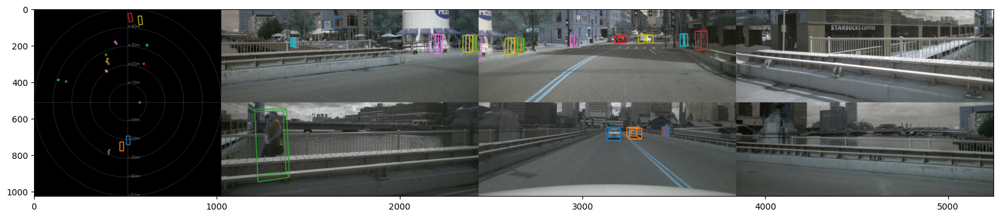

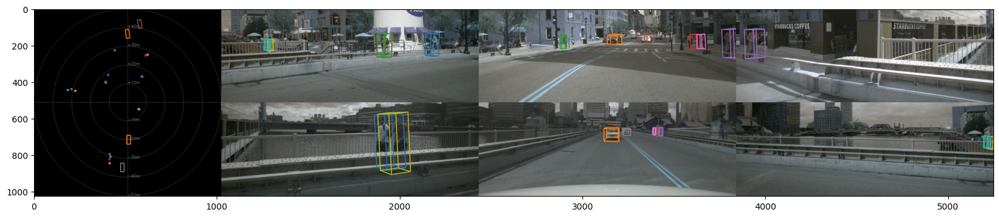

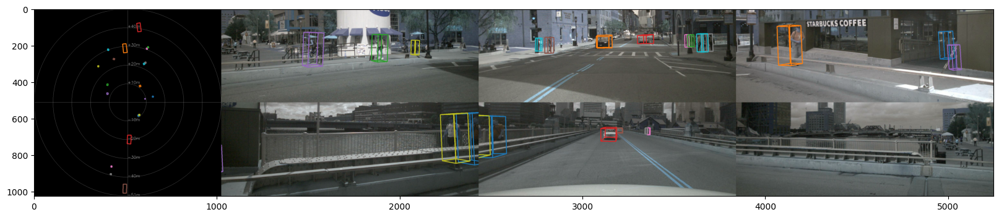

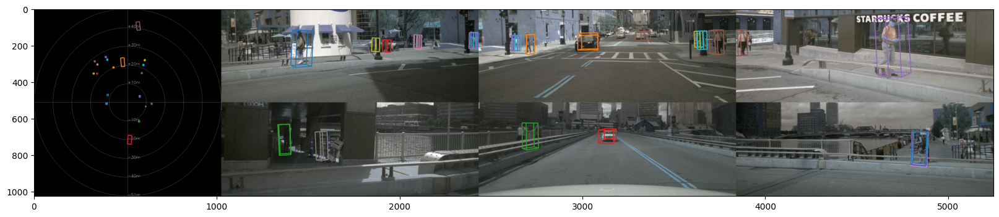

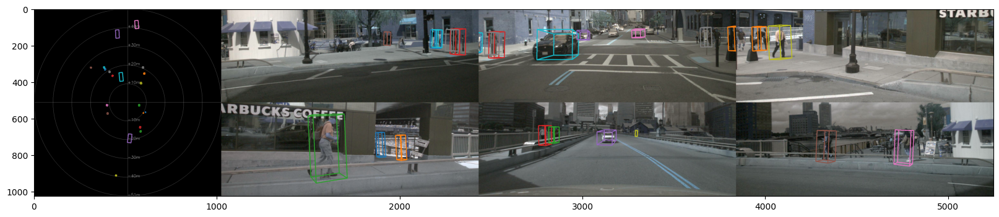

...

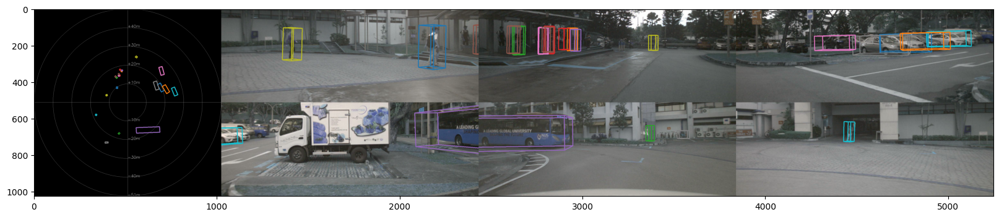

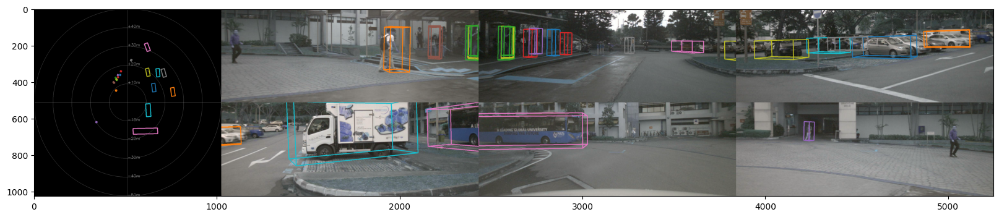

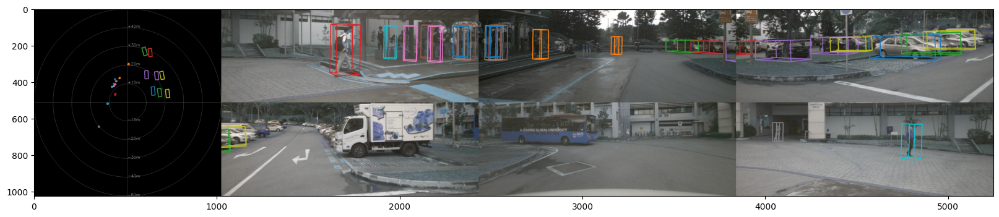

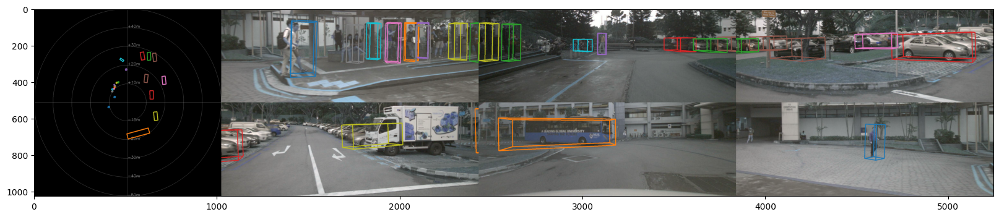

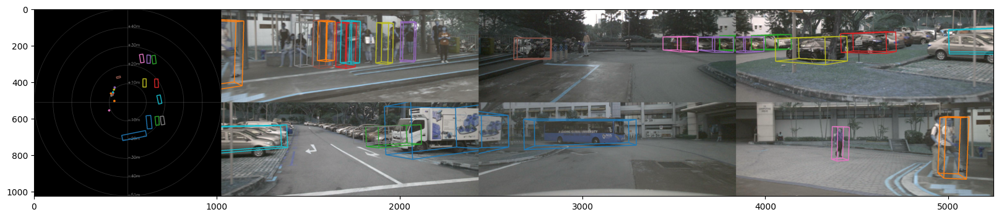

In [33]:
num_experiments = 50
for i in range(num_experiments):
    data = next(data_iter)
    if not data:
        break
    data = scatter(data, [gpu_id])[0]
    raw_imgs = torch.squeeze(data["img"][0], 0).permute(0, 2, 3, 1).cpu().numpy()
    raw_imgs = raw_imgs * img_norm_std + img_norm_mean
    
    result = inference(data)
    plot_result(result, raw_imgs, data, max_num_boxes=20)